Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: C:\Users\Codniv\anaconda3\envs\tf\lib\site-packages\lpips\weights\v0.1\alex.pth


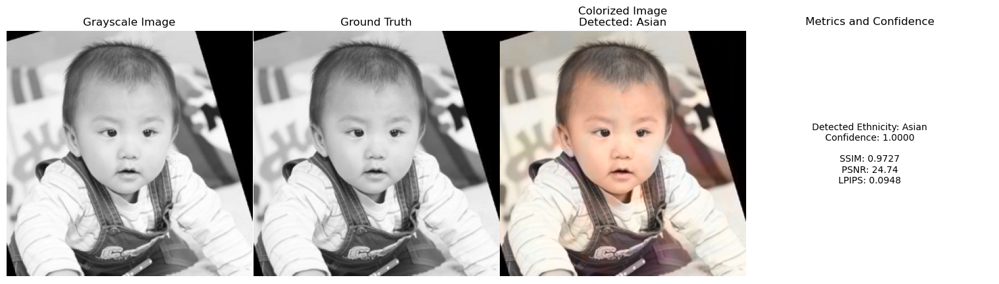

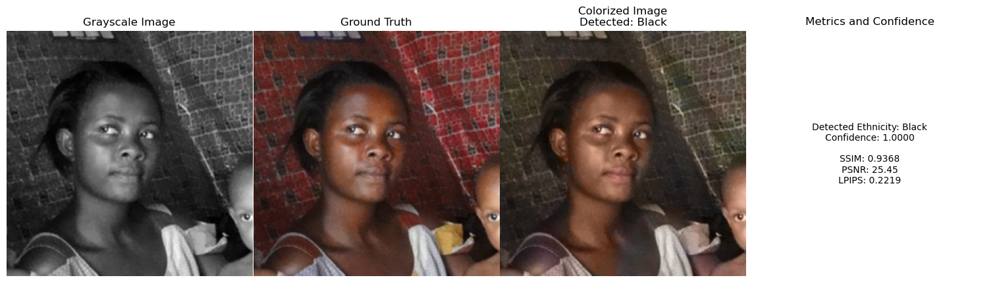

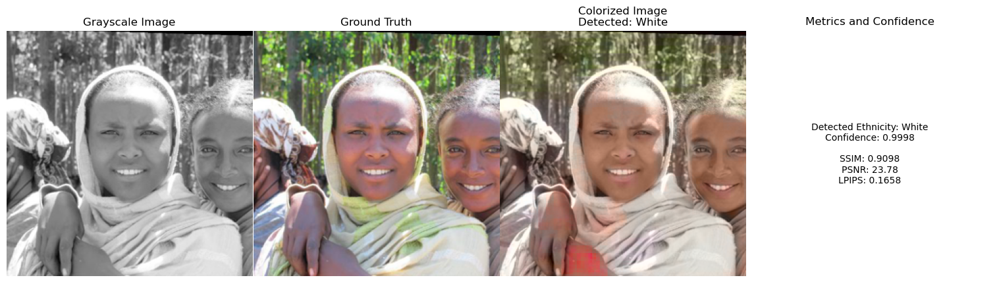

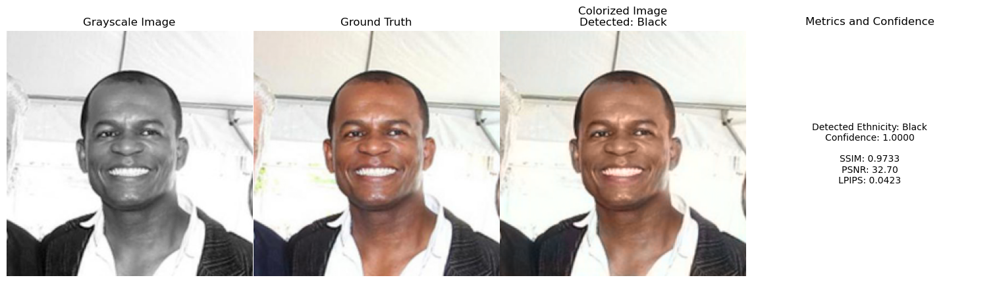

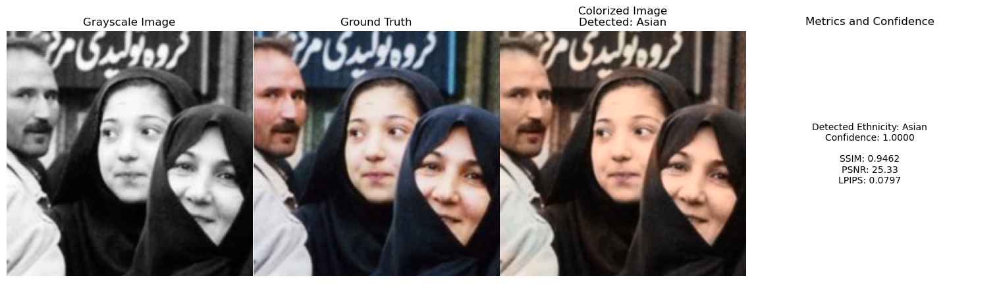

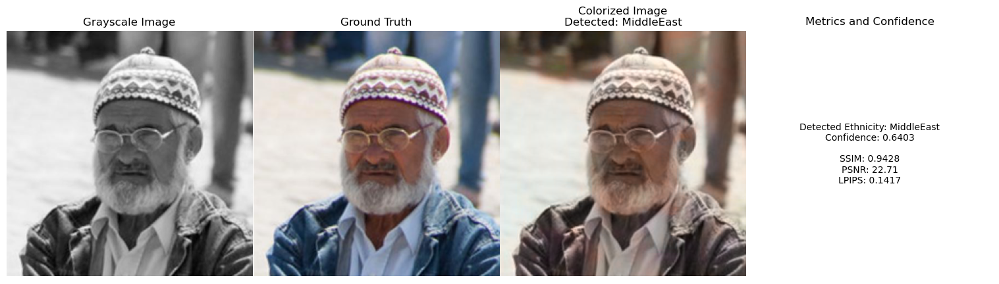

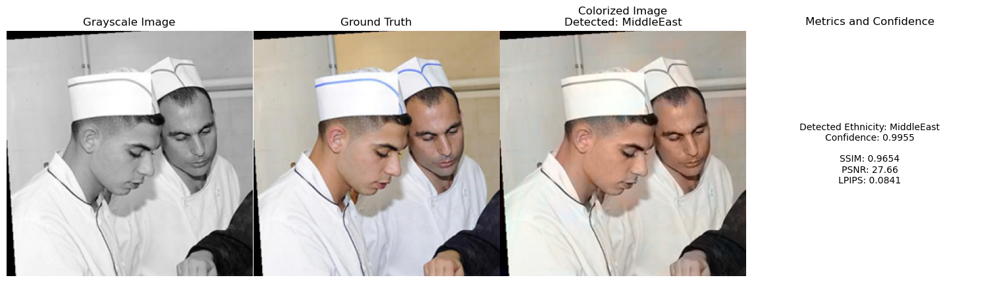

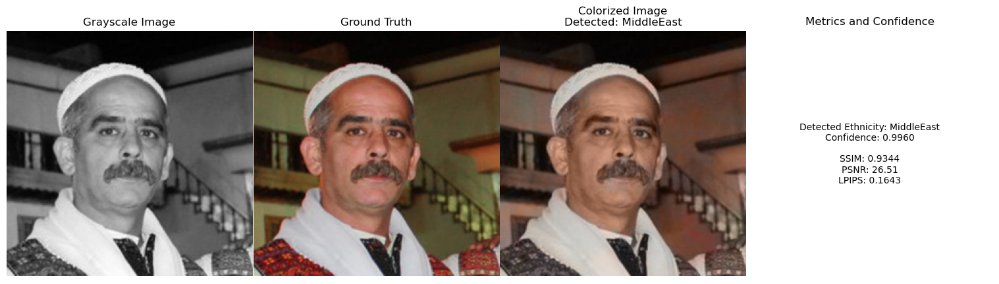

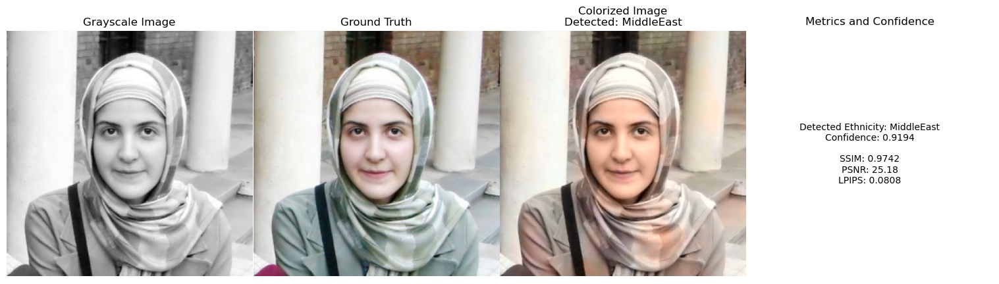

In [2]:
import os
import numpy as np
import tensorflow as tf
from PIL import Image
from skimage.color import rgb2lab, lab2rgb
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
import lpips
import torch
from torchvision import transforms
from skimage.metrics import structural_similarity as ssim

# Define the custom PSNR metric
def psnr_metric(y_true, y_pred):
    return tf.image.psnr(y_true, y_pred, max_val=1.0)

# Define the custom SSIM metric
def ssim_metric(y_true, y_pred):
    return tf.image.ssim(y_true, y_pred, max_val=1.0)

# Load the ethnicity detection model and the colorization model
ethnicity_model = load_model('my_model2E_900_1.h5')
colorization_model = load_model('fine_tuned_colorize_model.h5', custom_objects={'psnr_metric': psnr_metric, 'ssim_metric': ssim_metric})

# Initialize the LPIPS model
lpips_model = lpips.LPIPS(net='alex').eval()

# Function to load and preprocess the input image
def preprocess_image(image_path):
    image = Image.open(image_path).convert('RGB')
    image = image.resize((256, 256))
    image_np = np.array(image) / 255.0
    lab_image = rgb2lab(image_np)
    L_channel = lab_image[:, :, 0].reshape((256, 256, 1))
    
    return L_channel, image_np  # Return 1-channel grayscale and original RGB image

# Function to create a one-hot encoded class label
def create_one_hot_label(class_index, num_classes):
    one_hot_label = np.zeros((1, num_classes))
    one_hot_label[0, class_index] = 1
    return one_hot_label

# Function to calculate LPIPS
def load_image_for_lpips(image):
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    return transform(image).unsqueeze(0)  # Add batch dimension

# Enhanced function to display results with reduced spacing
def display_results_intuitive(image_path, class_names):
    # Preprocess the image for ethnicity detection (using RGB)
    _, rgb_image = preprocess_image(image_path)
    
    # Predict the ethnicity using the original RGB image, with verbosity turned off
    ethnicity_predictions = ethnicity_model.predict(rgb_image.reshape(1, 256, 256, 3), verbose=0)
    detected_class_index = np.argmax(ethnicity_predictions)
    detected_class_name = class_names[detected_class_index]
    confidence_score = ethnicity_predictions[0][detected_class_index]
    
    # Preprocess the image for colorization (using grayscale)
    L_channel, ground_truth = preprocess_image(image_path)
    
    # Create one-hot encoded label for the detected ethnicity
    one_hot_label = create_one_hot_label(detected_class_index, len(class_names))
    
    # Colorize the image using the detected ethnicity, with verbosity turned off
    predicted_ab = colorization_model.predict([L_channel.reshape(1, 256, 256, 1), one_hot_label], verbose=0)[0]
    
    # Combine L channel with predicted AB channels
    pred_lab_image = np.concatenate((L_channel, predicted_ab * 128), axis=-1)
    pred_rgb_image = lab2rgb(pred_lab_image)
    
    # Calculate SSIM, PSNR, and LPIPS metrics
    ssim_value = ssim(ground_truth, pred_rgb_image, channel_axis=2, data_range=1.0)
    psnr_value = tf.image.psnr(ground_truth, pred_rgb_image, max_val=1.0).numpy()
    lpips_value = lpips_model(load_image_for_lpips(Image.fromarray((ground_truth * 255).astype(np.uint8))), 
                              load_image_for_lpips(Image.fromarray((pred_rgb_image * 255).astype(np.uint8)))).item()
    
    # Enhanced display of results
    plt.figure(figsize=(15, 4))  # Adjusted figure size to reduce space
    
    plt.subplot(1, 4, 1)
    plt.imshow(L_channel.reshape(256, 256), cmap='gray')
    plt.title('Grayscale Image', fontsize=12)
    plt.axis('off')
    
    plt.subplot(1, 4, 2)
    plt.imshow(ground_truth)
    plt.title('Ground Truth', fontsize=12)
    plt.axis('off')
    
    plt.subplot(1, 4, 3)
    plt.imshow(pred_rgb_image)
    plt.title(f'Colorized Image\nDetected: {detected_class_name}', fontsize=12)
    plt.axis('off')
    
    plt.subplot(1, 4, 4)
    plt.text(0.5, 0.5, f'Detected Ethnicity: {detected_class_name}\n'
                       f'Confidence: {confidence_score:.4f}\n\n'
                       f'SSIM: {ssim_value:.4f}\n'
                       f'PSNR: {psnr_value:.2f}\n'
                       f'LPIPS: {lpips_value:.4f}', 
             horizontalalignment='center', verticalalignment='center', fontsize=10)
    plt.title('Metrics and Confidence', fontsize=12)
    plt.axis('off')
    
    plt.tight_layout(pad=0.1)  # Tight layout with reduced padding
    plt.show()

# Path to test images
test_image_dir = 'testi'  # Replace with the actual path to your test images
class_names = ['Asian', 'Black', 'Indian', 'Latino', 'MiddleEast', 'White']

# Iterate through test images and display results
for image_file in os.listdir(test_image_dir):
    image_path = os.path.join(test_image_dir, image_file)
    display_results_intuitive(image_path, class_names)


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/site-packages/lpips/weights/v0.1/alex.pth


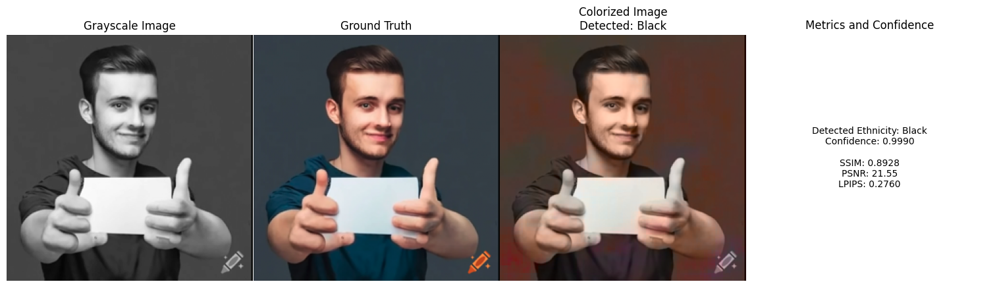

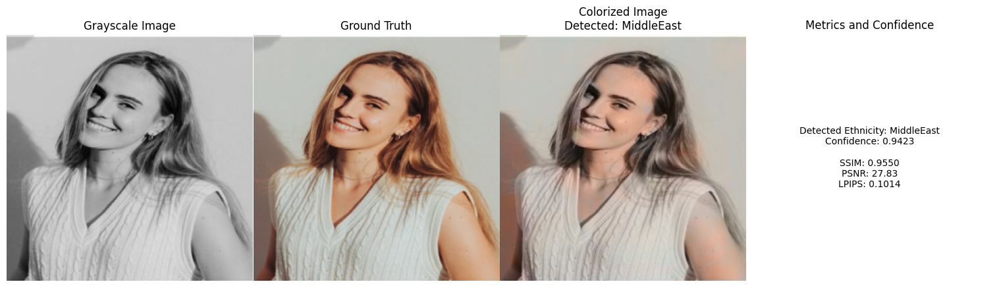

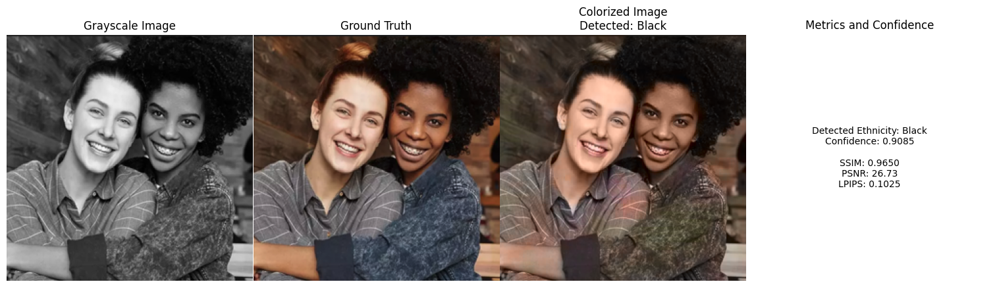

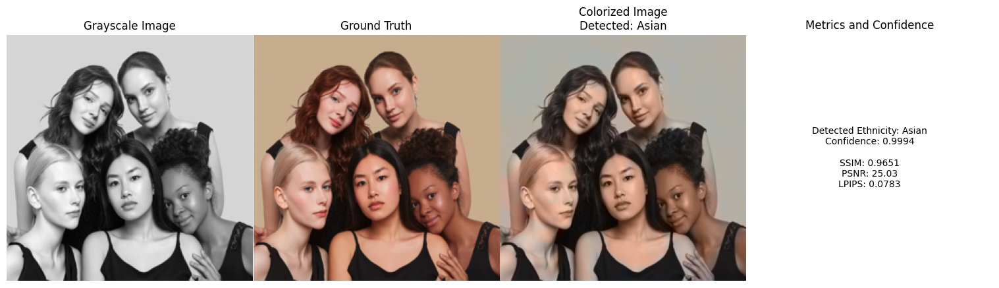

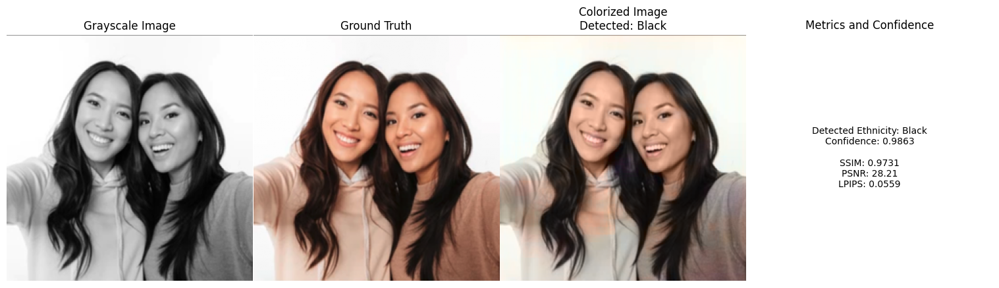

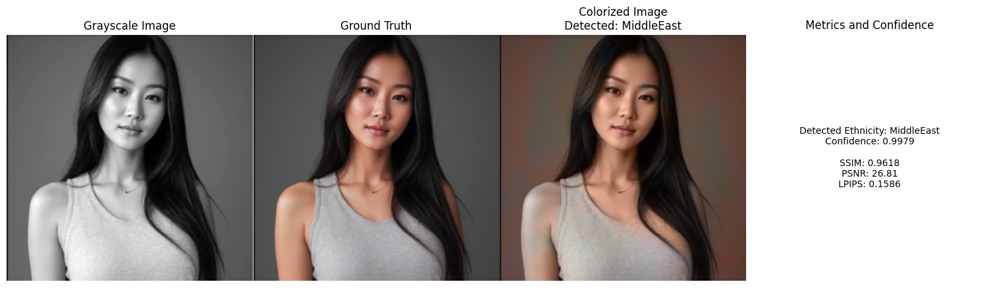

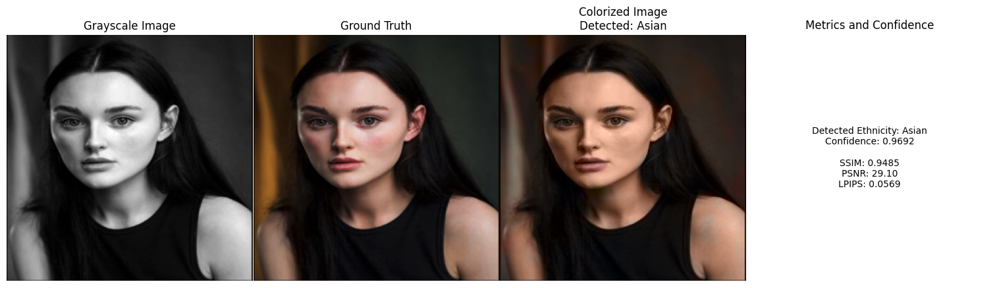

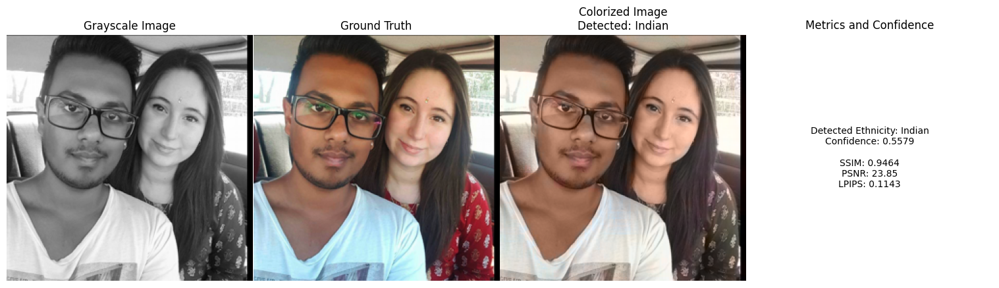

In [17]:
import os
import numpy as np
import tensorflow as tf
from PIL import Image
from skimage.color import rgb2lab, lab2rgb
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
import lpips
import torch
from torchvision import transforms
from skimage.metrics import structural_similarity as ssim

# Define the custom PSNR metric
def psnr_metric(y_true, y_pred):
    return tf.image.psnr(y_true, y_pred, max_val=1.0)

# Define the custom SSIM metric
def ssim_metric(y_true, y_pred):
    return tf.image.ssim(y_true, y_pred, max_val=1.0)

# Load the ethnicity detection model and the colorization model
ethnicity_model = load_model('EthnicModel.h5')
colorization_model = load_model('ColorizeTuned.h5', custom_objects={'psnr_metric': psnr_metric, 'ssim_metric': ssim_metric})

# Initialize the LPIPS model
lpips_model = lpips.LPIPS(net='alex').eval()

# Function to load and preprocess the input image
def preprocess_image(image_path):
    image = Image.open(image_path).convert('RGB')
    image = image.resize((256, 256))
    image_np = np.array(image) / 255.0
    lab_image = rgb2lab(image_np)
    L_channel = lab_image[:, :, 0].reshape((256, 256, 1))
    
    return L_channel, image_np  # Return 1-channel grayscale and original RGB image

# Function to create a one-hot encoded class label
def create_one_hot_label(class_index, num_classes):
    one_hot_label = np.zeros((1, num_classes))
    one_hot_label[0, class_index] = 1
    return one_hot_label

# Function to calculate LPIPS
def load_image_for_lpips(image):
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    return transform(image).unsqueeze(0)  # Add batch dimension

# Enhanced function to display results with reduced spacing
def display_results_intuitive(image_path, class_names):
    # Preprocess the image for ethnicity detection (using RGB)
    _, rgb_image = preprocess_image(image_path)
    
    # Predict the ethnicity using the original RGB image, with verbosity turned off
    ethnicity_predictions = ethnicity_model.predict(rgb_image.reshape(1, 256, 256, 3), verbose=0)
    detected_class_index = np.argmax(ethnicity_predictions)
    detected_class_name = class_names[detected_class_index]
    confidence_score = ethnicity_predictions[0][detected_class_index]
    
    # Preprocess the image for colorization (using grayscale)
    L_channel, ground_truth = preprocess_image(image_path)
    
    # Create one-hot encoded label for the detected ethnicity
    one_hot_label = create_one_hot_label(detected_class_index, len(class_names))
    
    # Colorize the image using the detected ethnicity, with verbosity turned off
    predicted_ab = colorization_model.predict([L_channel.reshape(1, 256, 256, 1), one_hot_label], verbose=0)[0]
    
    # Combine L channel with predicted AB channels
    pred_lab_image = np.concatenate((L_channel, predicted_ab * 128), axis=-1)
    pred_rgb_image = lab2rgb(pred_lab_image)
    
    # Calculate SSIM, PSNR, and LPIPS metrics
    ssim_value = ssim(ground_truth, pred_rgb_image, channel_axis=2, data_range=1.0)
    psnr_value = tf.image.psnr(ground_truth, pred_rgb_image, max_val=1.0).numpy()
    lpips_value = lpips_model(load_image_for_lpips(Image.fromarray((ground_truth * 255).astype(np.uint8))), 
                              load_image_for_lpips(Image.fromarray((pred_rgb_image * 255).astype(np.uint8)))).item()
    
    # Enhanced display of results
    plt.figure(figsize=(15, 4))  # Adjusted figure size to reduce space
    
    plt.subplot(1, 4, 1)
    plt.imshow(L_channel.reshape(256, 256), cmap='gray')
    plt.title('Grayscale Image', fontsize=12)
    plt.axis('off')
    
    plt.subplot(1, 4, 2)
    plt.imshow(ground_truth)
    plt.title('Ground Truth', fontsize=12)
    plt.axis('off')
    
    plt.subplot(1, 4, 3)
    plt.imshow(pred_rgb_image)
    plt.title(f'Colorized Image\nDetected: {detected_class_name}', fontsize=12)
    plt.axis('off')
    
    plt.subplot(1, 4, 4)
    plt.text(0.5, 0.5, f'Detected Ethnicity: {detected_class_name}\n'
                       f'Confidence: {confidence_score:.4f}\n\n'
                       f'SSIM: {ssim_value:.4f}\n'
                       f'PSNR: {psnr_value:.2f}\n'
                       f'LPIPS: {lpips_value:.4f}', 
             horizontalalignment='center', verticalalignment='center', fontsize=10)
    plt.title('Metrics and Confidence', fontsize=12)
    plt.axis('off')
    
    plt.tight_layout(pad=0.1)  # Tight layout with reduced padding
    plt.show()

# Path to test images
test_image_dir = 'multi'  # Replace with the actual path to your test images
class_names = ['Asian', 'Black', 'Indian', 'Latino', 'MiddleEast', 'White']

# Valid image extensions
valid_extensions = ('.jpg', '.jpeg', '.png', '.bmp', '.tiff')

# Iterate through test images and display results
for image_file in os.listdir(test_image_dir):
    if image_file.lower().endswith(valid_extensions):
        image_path = os.path.join(test_image_dir, image_file)
        display_results_intuitive(image_path, class_names)


In [3]:
import os
import numpy as np
import tensorflow as tf
from PIL import Image
from skimage.color import rgb2lab, lab2rgb
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from tensorflow.keras.models import load_model
import lpips
import torch
from torchvision import transforms
from skimage.metrics import structural_similarity as ssim

# Define the custom PSNR metric
def psnr_metric(y_true, y_pred):
    return tf.image.psnr(y_true, y_pred, max_val=1.0)

# Define the custom SSIM metric
def ssim_metric(y_true, y_pred):
    return tf.image.ssim(y_true, y_pred, max_val=1.0)

# Load the ethnicity detection model and the colorization model
ethnicity_model = load_model('my_model2E_900_1.h5')
colorization_model = load_model('fine_tuned_colorize_model.h5', custom_objects={'psnr_metric': psnr_metric, 'ssim_metric': ssim_metric})

# Initialize the LPIPS model
lpips_model = lpips.LPIPS(net='alex').eval()

# Function to load and preprocess the input image
def preprocess_image(image_path):
    image = Image.open(image_path).convert('RGB')
    image = image.resize((256, 256))
    image_np = np.array(image) / 255.0
    lab_image = rgb2lab(image_np)
    L_channel = lab_image[:, :, 0].reshape((256, 256, 1))
    
    return L_channel, image_np  # Return 1-channel grayscale and original RGB image

# Function to create a one-hot encoded class label
def create_one_hot_label(class_index, num_classes):
    one_hot_label = np.zeros((1, num_classes))
    one_hot_label[0, class_index] = 1
    return one_hot_label

# Function to calculate LPIPS
def load_image_for_lpips(image):
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    return transform(image).unsqueeze(0)  # Add batch dimension

# Function to display results and save them to a PDF
def display_results_and_save_to_pdf(image_path, class_names, pdf):
    # Preprocess the image for ethnicity detection (using RGB)
    _, rgb_image = preprocess_image(image_path)
    
    # Predict the ethnicity using the original RGB image, with verbosity turned off
    ethnicity_predictions = ethnicity_model.predict(rgb_image.reshape(1, 256, 256, 3), verbose=0)
    detected_class_index = np.argmax(ethnicity_predictions)
    detected_class_name = class_names[detected_class_index]
    confidence_score = ethnicity_predictions[0][detected_class_index]
    
    # Preprocess the image for colorization (using grayscale)
    L_channel, ground_truth = preprocess_image(image_path)
    
    # Create one-hot encoded label for the detected ethnicity
    one_hot_label = create_one_hot_label(detected_class_index, len(class_names))
    
    # Colorize the image using the detected ethnicity, with verbosity turned off
    predicted_ab = colorization_model.predict([L_channel.reshape(1, 256, 256, 1), one_hot_label], verbose=0)[0]
    
    # Combine L channel with predicted AB channels
    pred_lab_image = np.concatenate((L_channel, predicted_ab * 128), axis=-1)
    pred_rgb_image = lab2rgb(pred_lab_image)
    
    # Calculate SSIM, PSNR, and LPIPS metrics
    ssim_value = ssim(ground_truth, pred_rgb_image, channel_axis=2, data_range=1.0)
    psnr_value = tf.image.psnr(ground_truth, pred_rgb_image, max_val=1.0).numpy()
    lpips_value = lpips_model(load_image_for_lpips(Image.fromarray((ground_truth * 255).astype(np.uint8))), 
                              load_image_for_lpips(Image.fromarray((pred_rgb_image * 255).astype(np.uint8)))).item()
    
    # Create a figure to display the results
    plt.figure(figsize=(15, 4))  # Adjusted figure size to reduce space
    
    plt.subplot(1, 4, 1)
    plt.imshow(L_channel.reshape(256, 256), cmap='gray')
    plt.title('Grayscale Image', fontsize=12)
    plt.axis('off')
    
    plt.subplot(1, 4, 2)
    plt.imshow(ground_truth)
    plt.title('Ground Truth', fontsize=12)
    plt.axis('off')
    
    plt.subplot(1, 4, 3)
    plt.imshow(pred_rgb_image)
    plt.title(f'Colorized Image\nDetected: {detected_class_name}', fontsize=12)
    plt.axis('off')
    
    plt.subplot(1, 4, 4)
    plt.text(0.5, 0.5, f'Detected Ethnicity: {detected_class_name}\n'
                       f'Confidence: {confidence_score:.4f}\n\n'
                       f'SSIM: {ssim_value:.4f}\n'
                       f'PSNR: {psnr_value:.2f}\n'
                       f'LPIPS: {lpips_value:.4f}', 
             horizontalalignment='center', verticalalignment='center', fontsize=10)
    plt.title('Metrics and Confidence', fontsize=12)
    plt.axis('off')
    
    plt.tight_layout(pad=0.1)  # Tight layout with reduced padding
    
    # Save the current figure to the PDF
    pdf.savefig()
    plt.close()

# Path to test images
test_image_dir = 'testi'  # Replace with the actual path to your test images
class_names = ['Asian', 'Black', 'Indian', 'Latino', 'MiddleEast', 'White']

# Create a PDF to save the results
with PdfPages('output_results.pdf') as pdf:
    # Iterate through test images and save results to the PDF
    for image_file in os.listdir(test_image_dir):
        image_path = os.path.join(test_image_dir, image_file)
        display_results_and_save_to_pdf(image_path, class_names, pdf)


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


C:\Users\Codniv\anaconda3\envs\tf\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Codniv\anaconda3\envs\tf\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: C:\Users\Codniv\anaconda3\envs\tf\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Codniv\anaconda3\envs\tf\lib\site-packages\lpips\lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_path, map_locatio

In [2]:
import os
import numpy as np
import tensorflow as tf
from PIL import Image
from skimage.color import rgb2lab, lab2rgb
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
from tensorflow.keras.models import load_model
import lpips
import torch
from torchvision import transforms
from skimage.metrics import structural_similarity as ssim

# Define the custom PSNR metric
def psnr_metric(y_true, y_pred):
    return tf.image.psnr(y_true, y_pred, max_val=1.0)

# Define the custom SSIM metric
def ssim_metric(y_true, y_pred):
    return tf.image.ssim(y_true, y_pred, max_val=1.0)

# Load the ethnicity detection model and the colorization model
ethnicity_model = load_model('my_model2E_900_1.h5')
colorization_model = load_model('fine_tuned_colorize_model.h5', custom_objects={'psnr_metric': psnr_metric, 'ssim_metric': ssim_metric})

# Initialize the LPIPS model
lpips_model = lpips.LPIPS(net='alex').eval()

# Function to load and preprocess the input image
def preprocess_image(image_path):
    image = Image.open(image_path).convert('RGB')
    image = image.resize((256, 256))
    image_np = np.array(image) / 255.0
    lab_image = rgb2lab(image_np)
    L_channel = lab_image[:, :, 0].reshape((256, 256, 1))
    
    return L_channel, image_np  # Return 1-channel grayscale and original RGB image

# Function to create a one-hot encoded class label
def create_one_hot_label(class_index, num_classes):
    one_hot_label = np.zeros((1, num_classes))
    one_hot_label[0, class_index] = 1
    return one_hot_label

# Function to calculate LPIPS
def load_image_for_lpips(image):
    transform = transforms.Compose([
        transforms.Resize((256, 256)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
    return transform(image).unsqueeze(0)  # Add batch dimension

# Store results in a PDF and compile summary statistics
def generate_report(test_image_dir, class_names):
    pdf = PdfPages('research_demo_report.pdf')
    summary_stats = {'ethnicity_counts': {name: 0 for name in class_names},
                     'high_confidence_counts': {name: 0 for name in class_names},
                     'psnr_values': [],
                     'ssim_values': [],
                     'lpips_values': []}

    for image_file in os.listdir(test_image_dir):
        image_path = os.path.join(test_image_dir, image_file)

        # Preprocess the image for ethnicity detection (using RGB)
        _, rgb_image = preprocess_image(image_path)
        
        # Predict the ethnicity using the original RGB image, with verbosity turned off
        ethnicity_predictions = ethnicity_model.predict(rgb_image.reshape(1, 256, 256, 3), verbose=0)
        detected_class_index = np.argmax(ethnicity_predictions)
        detected_class_name = class_names[detected_class_index]
        confidence_score = ethnicity_predictions[0][detected_class_index]

        # Preprocess the image for colorization (using grayscale)
        L_channel, ground_truth = preprocess_image(image_path)
        
        # Create one-hot encoded label for the detected ethnicity
        one_hot_label = create_one_hot_label(detected_class_index, len(class_names))
        
        # Colorize the image using the detected ethnicity, with verbosity turned off
        predicted_ab = colorization_model.predict([L_channel.reshape(1, 256, 256, 1), one_hot_label], verbose=0)[0]
        
        # Combine L channel with predicted AB channels
        pred_lab_image = np.concatenate((L_channel, predicted_ab * 128), axis=-1)
        pred_rgb_image = lab2rgb(pred_lab_image)
        
        # Calculate SSIM, PSNR, and LPIPS metrics
        ssim_value = ssim(ground_truth, pred_rgb_image, channel_axis=2, data_range=1.0)
        psnr_value = tf.image.psnr(ground_truth, pred_rgb_image, max_val=1.0).numpy()
        lpips_value = lpips_model(load_image_for_lpips(Image.fromarray((ground_truth * 255).astype(np.uint8))), 
                                  load_image_for_lpips(Image.fromarray((pred_rgb_image * 255).astype(np.uint8)))).item()
        
        # Store metrics in summary statistics
        summary_stats['psnr_values'].append(psnr_value)
        summary_stats['ssim_values'].append(ssim_value)
        summary_stats['lpips_values'].append(lpips_value)
        summary_stats['ethnicity_counts'][detected_class_name] += 1
        if confidence_score > 0.8:  # Define high confidence as > 0.8
            summary_stats['high_confidence_counts'][detected_class_name] += 1

        # Generate a report page for the current image
        plt.figure(figsize=(15, 4))
        
        plt.subplot(1, 4, 1)
        plt.imshow(L_channel.reshape(256, 256), cmap='gray')
        plt.title('Grayscale Image', fontsize=12)
        plt.axis('off')
        
        plt.subplot(1, 4, 2)
        plt.imshow(ground_truth)
        plt.title('Ground Truth', fontsize=12)
        plt.axis('off')
        
        plt.subplot(1, 4, 3)
        plt.imshow(pred_rgb_image)
        plt.title(f'Colorized Image\nDetected: {detected_class_name}', fontsize=12)
        plt.axis('off')
        
        plt.subplot(1, 4, 4)
        plt.text(0.5, 0.5, f'Detected Ethnicity: {detected_class_name}\n'
                           f'Confidence: {confidence_score:.4f}\n\n'
                           f'SSIM: {ssim_value:.4f}\n'
                           f'PSNR: {psnr_value:.2f}\n'
                           f'LPIPS: {lpips_value:.4f}', 
                 horizontalalignment='center', verticalalignment='center', fontsize=10)
        plt.title('Metrics and Confidence', fontsize=12)
        plt.axis('off')
        
        plt.tight_layout(pad=0.1)
        pdf.savefig()
        plt.close()

    # Generate summary statistics page
    plt.figure(figsize=(10, 5))
    
    plt.subplot(1, 2, 1)
    plt.bar(summary_stats['ethnicity_counts'].keys(), summary_stats['ethnicity_counts'].values(), color='skyblue')
    plt.title('Ethnicity Detection Counts')
    plt.xlabel('Ethnicity')
    plt.ylabel('Count')
    
    plt.subplot(1, 2, 2)
    plt.bar(summary_stats['high_confidence_counts'].keys(), summary_stats['high_confidence_counts'].values(), color='salmon')
    plt.title('High Confidence Detections')
    plt.xlabel('Ethnicity')
    plt.ylabel('High Confidence Count')
    
    plt.tight_layout()
    pdf.savefig()
    plt.close()

    pdf.close()

# Path to test images
test_image_dir = 'testi'  # Replace with the actual path to your test images
class_names = ['Asian', 'Black', 'Indian', 'Latino', 'MiddleEast', 'White']

# Generate the report
generate_report(test_image_dir, class_names)


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


C:\Users\Codniv\anaconda3\envs\tf\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\Codniv\anaconda3\envs\tf\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: C:\Users\Codniv\anaconda3\envs\tf\lib\site-packages\lpips\weights\v0.1\alex.pth


C:\Users\Codniv\anaconda3\envs\tf\lib\site-packages\lpips\lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_path, map_locatio

1/1 [==============================] - 0s 16ms/step


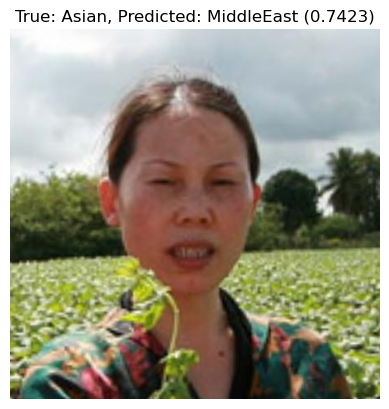

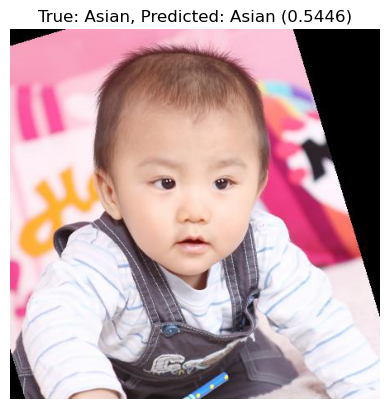

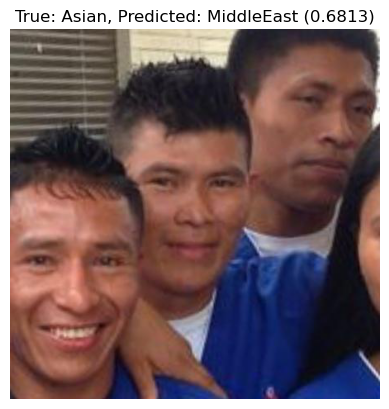

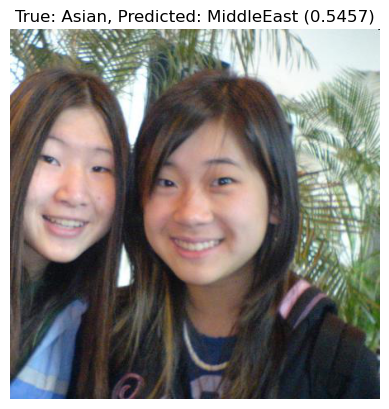

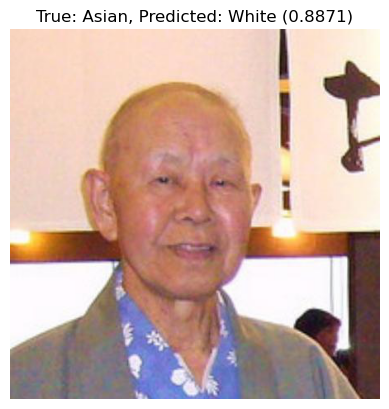

...

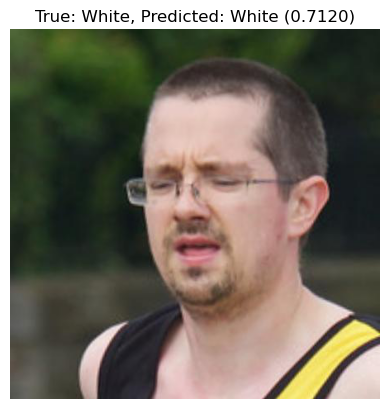

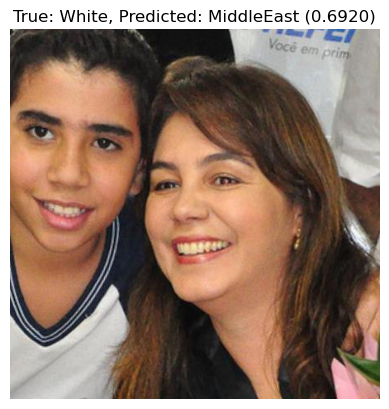

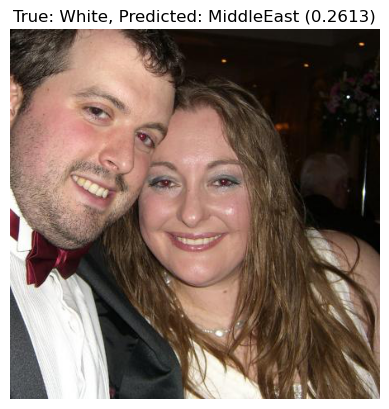

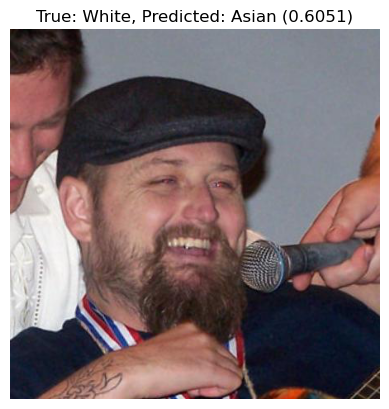

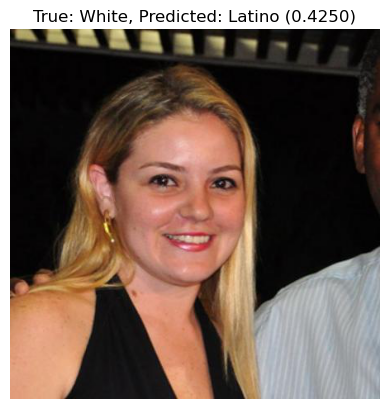

In [10]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
import os
import matplotlib.pyplot as plt

# Load the fine-tuned model
model = load_model('my_model2E_900_1.h5')

# Define the class names as they were during training
class_names = ['Asian', 'Black', 'Indian', 'Latino', 'MiddleEast', 'White']

# Function to preprocess the image
def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(256, 256))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Normalize the image
    return img_array

# Paths to the test images directory
test_dir = 'test'

# Lists to store image details
image_details = []

# Iterate through each class folder in the test directory
for class_name in class_names:
    class_dir = os.path.join(test_dir, class_name)
    if os.path.isdir(class_dir):
        for img_name in os.listdir(class_dir):
            img_path = os.path.join(class_dir, img_name)
            # Preprocess the image
            processed_image = preprocess_image(img_path)
            # Make a prediction
            predictions = model.predict(processed_image)
            # Get the class with the highest probability
            predicted_class = np.argmax(predictions, axis=1)[0]
            predicted_class_name = class_names[predicted_class]
            # Get the score of the predicted class
            predicted_score = predictions[0][predicted_class]
            
            # Append image details
            image_details.append({
                'image_path': img_path,
                'true_label': class_name,
                'predicted_label': predicted_class_name,
                'predicted_score': predicted_score
            })

# Display the results
for detail in image_details:
    # Load the image
    img = image.load_img(detail['image_path'])
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"True: {detail['true_label']}, Predicted: {detail['predicted_label']} ({detail['predicted_score']:.4f})")
    plt.show()


1/1 [==============================] - 0s 21ms/step


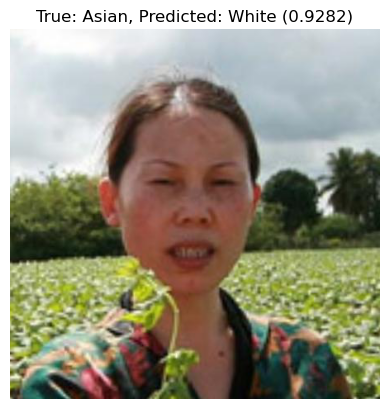

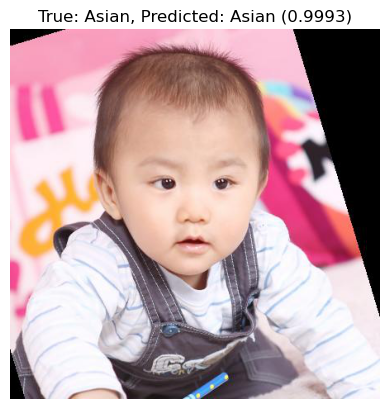

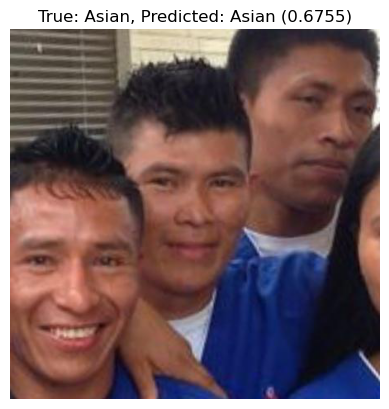

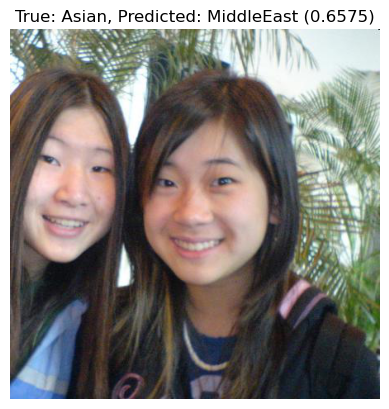

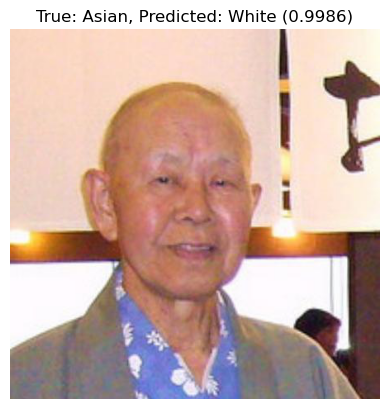

...

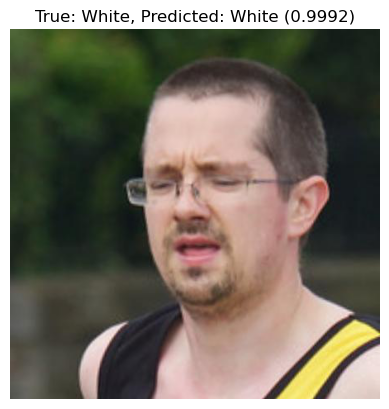

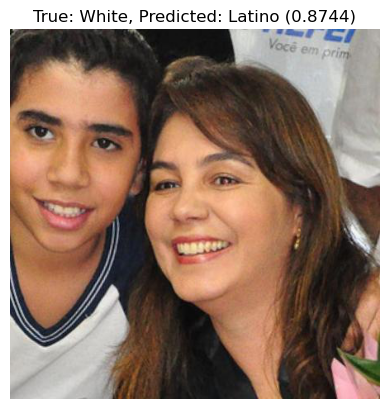

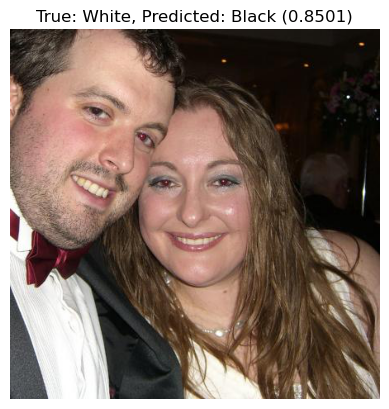

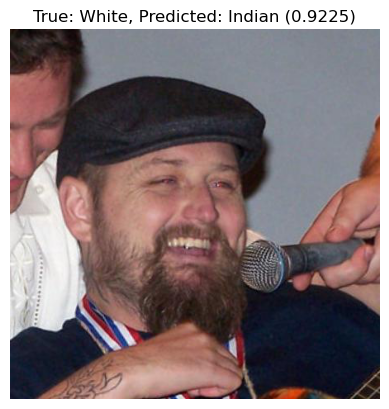

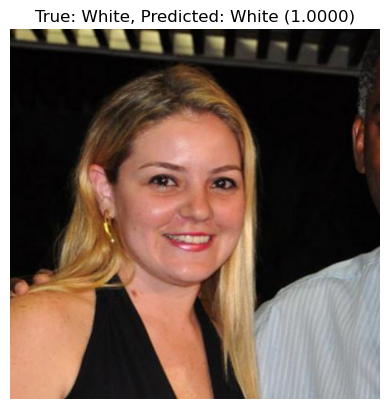

In [5]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
import os
import matplotlib.pyplot as plt

# Load the fine-tuned model
model = load_model('my_model2E_900_2.h5')

# Define the class names as they were during training
class_names = ['Asian', 'Black', 'Indian', 'Latino', 'MiddleEast', 'White']

# Function to preprocess the image
def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(256, 256))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Normalize the image
    return img_array

# Paths to the test images directory
test_dir = 'test'

# Lists to store image details
image_details = []

# Iterate through each class folder in the test directory
for class_name in class_names:
    class_dir = os.path.join(test_dir, class_name)
    if os.path.isdir(class_dir):
        for img_name in os.listdir(class_dir):
            img_path = os.path.join(class_dir, img_name)
            # Preprocess the image
            processed_image = preprocess_image(img_path)
            # Make a prediction
            predictions = model.predict(processed_image)
            # Get the class with the highest probability
            predicted_class = np.argmax(predictions, axis=1)[0]
            predicted_class_name = class_names[predicted_class]
            # Get the score of the predicted class
            predicted_score = predictions[0][predicted_class]
            
            # Append image details
            image_details.append({
                'image_path': img_path,
                'true_label': class_name,
                'predicted_label': predicted_class_name,
                'predicted_score': predicted_score
            })

# Display the results
for detail in image_details:
    # Load the image
    img = image.load_img(detail['image_path'])
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"True: {detail['true_label']}, Predicted: {detail['predicted_label']} ({detail['predicted_score']:.4f})")
    plt.show()


1/1 [==============================] - 0s 31ms/step


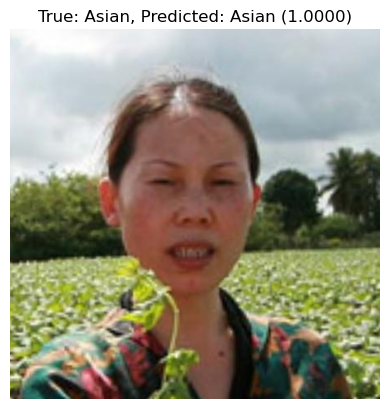

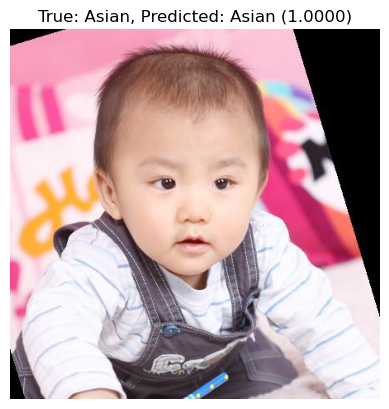

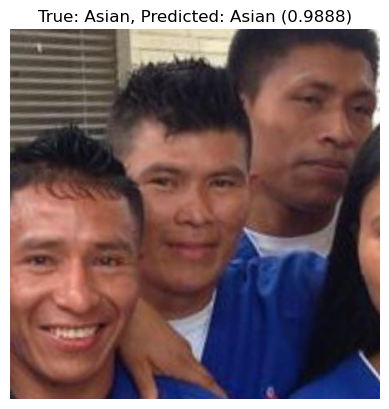

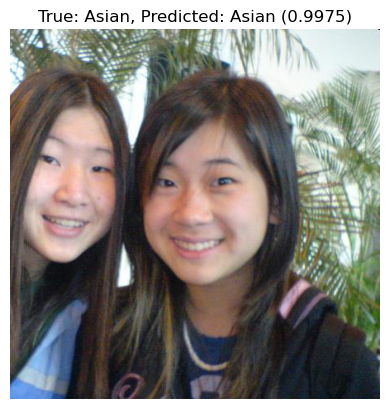

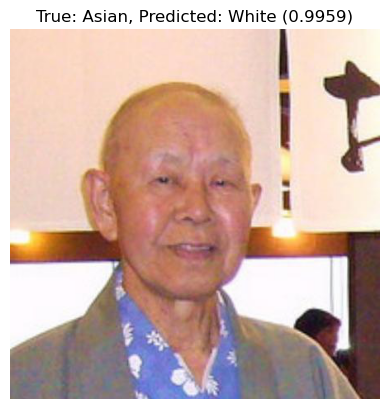

...

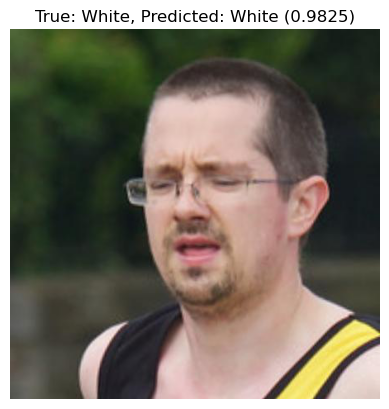

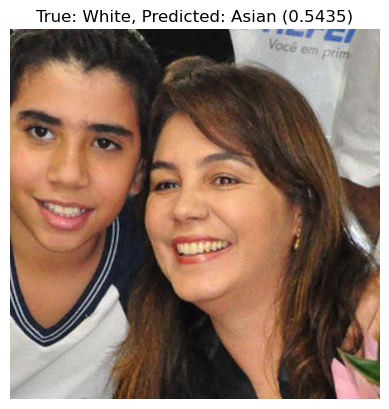

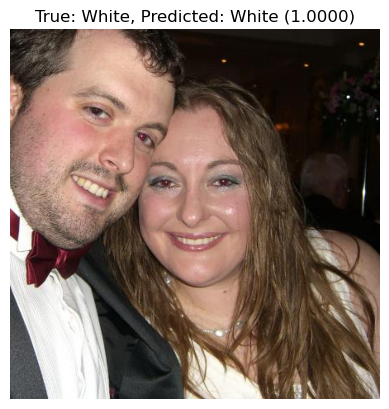

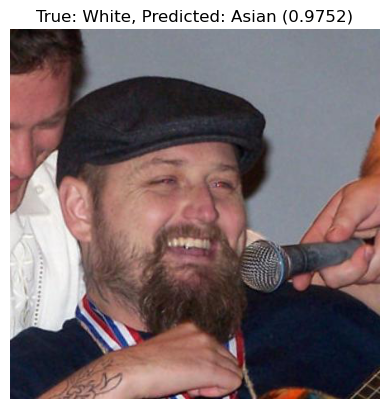

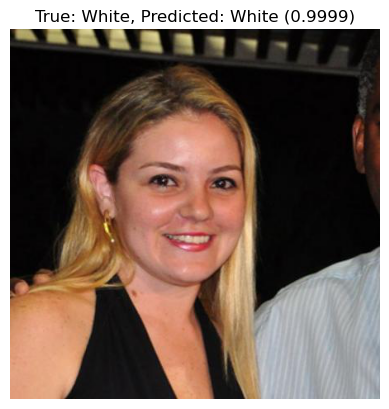

In [6]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
import os
import matplotlib.pyplot as plt

# Load the fine-tuned model
model = load_model('my_model2E_900_1.h5')

# Define the class names as they were during training
class_names = ['Asian', 'Black', 'Indian', 'Latino', 'MiddleEast', 'White']

# Function to preprocess the image
def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(256, 256))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Normalize the image
    return img_array

# Paths to the test images directory
test_dir = 'test'

# Lists to store image details
image_details = []

# Iterate through each class folder in the test directory
for class_name in class_names:
    class_dir = os.path.join(test_dir, class_name)
    if os.path.isdir(class_dir):
        for img_name in os.listdir(class_dir):
            img_path = os.path.join(class_dir, img_name)
            # Preprocess the image
            processed_image = preprocess_image(img_path)
            # Make a prediction
            predictions = model.predict(processed_image)
            # Get the class with the highest probability
            predicted_class = np.argmax(predictions, axis=1)[0]
            predicted_class_name = class_names[predicted_class]
            # Get the score of the predicted class
            predicted_score = predictions[0][predicted_class]
            
            # Append image details
            image_details.append({
                'image_path': img_path,
                'true_label': class_name,
                'predicted_label': predicted_class_name,
                'predicted_score': predicted_score
            })

# Display the results
for detail in image_details:
    # Load the image
    img = image.load_img(detail['image_path'])
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"True: {detail['true_label']}, Predicted: {detail['predicted_label']} ({detail['predicted_score']:.4f})")
    plt.show()
